In [2]:
import os
import glob
import pandas as pd

In [3]:
# Get the file names from ../runs/predict-cls/exp/labels/
path = '../runs/predict-cls/exp/labels/'
files = glob.glob(path + '*.txt')

# for each file, get the name of the file before the '_' and check if it matches the number at the end of the first line of the file
# if it doesn't match, add the file name to a list
preds = pd.DataFrame(columns=['file','predicted', 'actual'])
for file in files:
    file_name = file.split('/')[-1]
    actual = file_name.split('_')[0]
    actual = int(actual)
    with open(file, 'r') as f:
        first_line = f.readline()
        predicted = first_line.split(' ')[1]
        predicted = int(predicted)
        if predicted != actual:
            image_file_path = '../runs/predict-cls/exp/' + file_name.split('.')[0] + '.jpg'
            preds = pd.concat([preds, pd.DataFrame([[image_file_path, predicted, actual]], columns=['file','predicted', 'actual'])], ignore_index=True)


In [4]:
preds

,file,predicted,actual
0,../runs/predict-cls/exp/15544496_2.jpg,15653990,15544496
1,../runs/predict-cls/exp/15416618_1.jpg,15455814,15416618
2,../runs/predict-cls/exp/13562315_1.jpg,15921579,13562315
3,../runs/predict-cls/exp/14866702_2.jpg,15055310,14866702
4,../runs/predict-cls/exp/15290914_0.jpg,12160217,15290914
...,...,...,...
105,../runs/predict-cls/exp/16098680_3.jpg,14949025,16098680
106,../runs/predict-cls/exp/14305098_1.jpg,13057271,14305098
107,../runs/predict-cls/exp/16194120_0.jpg,15426902,16194120
108,../runs/predict-cls/exp/15981149_0.jpg,12662164,15981149


In [5]:
# Get the paths for the predicted and actual images
for index, row in preds.iterrows():
    row['predicted'] = '/Users/rz20505/Documents/training_year/applied_data_science/data/uob_image_set_resized/' + str(row['predicted']) + '/'
    row['actual'] = '/Users/rz20505/Documents/training_year/applied_data_science/data/uob_image_set_resized/' + str(row['actual']) + '/'

In [6]:
# Turn the folder paths in the predicted and actual columns into lists of file names, preserving the path
preds['predicted'] = preds['predicted'].apply(lambda x: [x + file for file in os.listdir(x)])
preds['actual'] = preds['actual'].apply(lambda x: [x + file for file in os.listdir(x)])


In [7]:
# load the images using the file paths in the preds dataframe and place them in a new dataframe
import cv2
import numpy as np

def load_images_from_folder(folder):
    images = []
    for filename in folder:
        img = cv2.imread(filename)
        if img is not None:
            images.append(img)
    return images
# duplicate preds df
preds_paths = preds.copy()

preds['predicted'] = preds['predicted'].apply(lambda x: load_images_from_folder(x))
preds['actual'] = preds['actual'].apply(lambda x: load_images_from_folder(x))
preds['file'] = preds['file'].apply(lambda x: load_images_from_folder([x]))

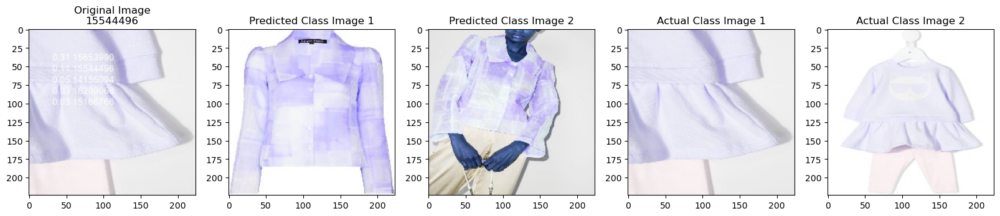

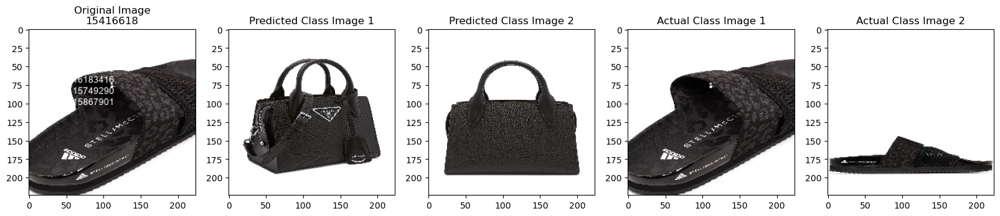

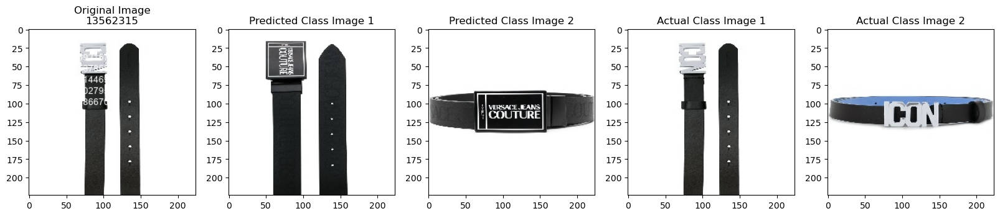

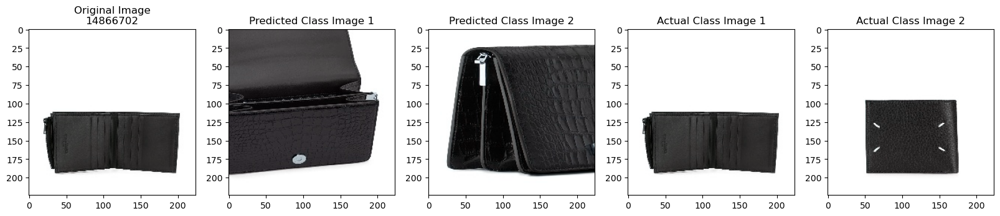

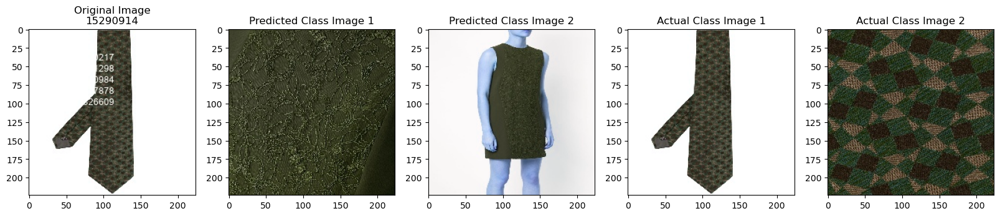

...

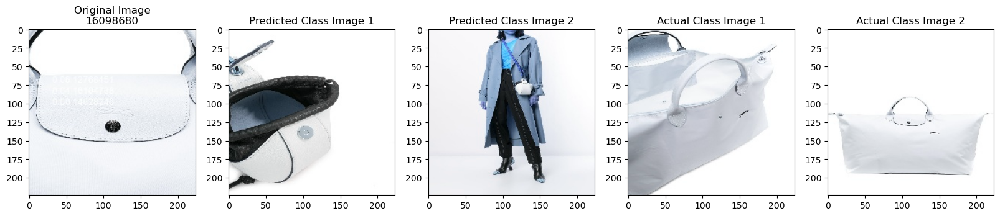

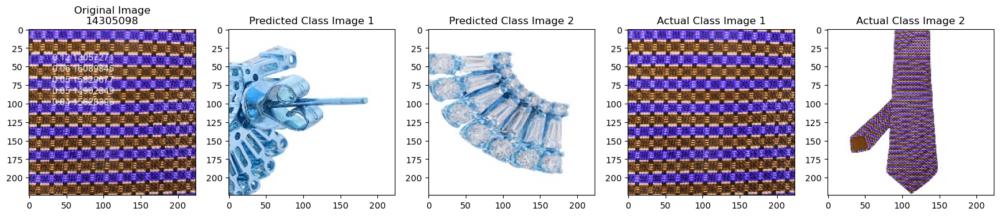

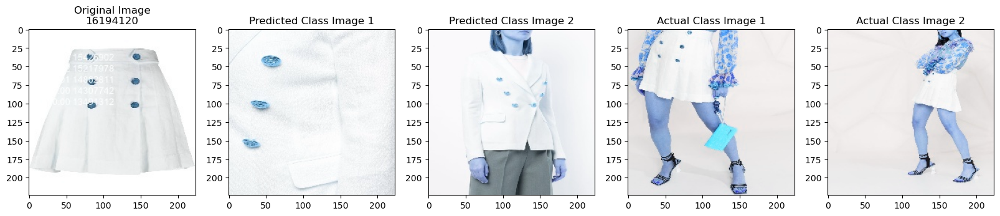

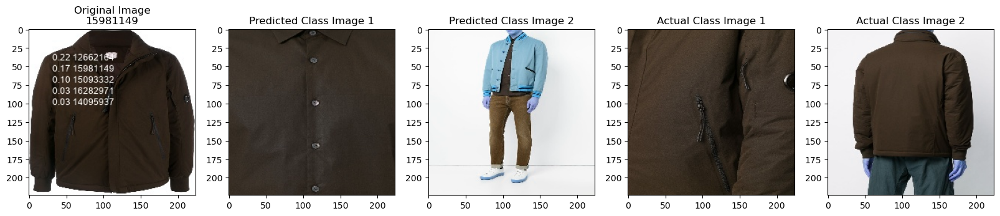

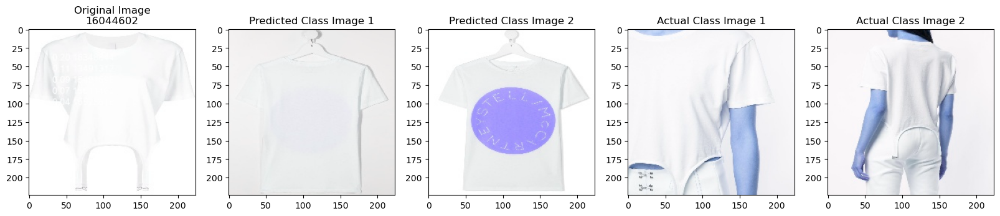

In [8]:
# Display the first 50 examples of the bad predictions with all the predicted and actual images
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

for index, row in preds.iterrows():
    fig, axs = plt.subplots(1, 5, figsize=(20, 20))
    axs[0].imshow(row['file'][0])
    axs[1].imshow(row['predicted'][0])
    axs[2].imshow(row['predicted'][1])
    axs[3].imshow(row['actual'][0])
    axs[4].imshow(row['actual'][1])
    # labels
    # extract file name from file path using index in preds_paths
    file_name = preds_paths['file'][index].split('/')[-1]
    # extract actual class from file name
    class_name = file_name.split('_')[0]
    axs[0].set_title('Original Image\n' + class_name)
    axs[1].set_title('Predicted Class Image 1')
    axs[2].set_title('Predicted Class Image 2')
    axs[3].set_title('Actual Class Image 1')
    axs[4].set_title('Actual Class Image 2')
    plt.show()